In [ ]:
#%% LOAD THE LIBRARIES
from sklearn.naive_bayes import GaussianNB
import itertools

from sklearn.ensemble import RandomForestClassifier
from sklearn.preprocessing import StandardScaler

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.layers import InputLayer
from tensorflow.keras.utils import to_categorical

import numpy as np
import pandas as pd
import cv2 as cv

import matplotlib
matplotlib.rcParams['figure.dpi'] = 125
import matplotlib.pyplot as plt
#from importance.imutils import imshow
from sklearn.tree import DecisionTreeClassifier
from tqdm import tqdm
#from skimage.feature import greycomatrix, greycoprops
from skimage.color import rgb2gray
from sklearn.metrics import classification_report, confusion_matrix
import skimage
from sklearn.svm import SVC


from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score
from sklearn.metrics import classification_report
from sklearn.metrics import confusion_matrix
import seaborn as sns

from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from sklearn.ensemble import RandomForestClassifier

plt.rcParams["figure.dpi"] = 150

from IPython.display import HTML
shell = get_ipython()

def adjust_font_size():
  display(HTML('''<style>
    body {
      font-size: 16px;
    }
  '''))

if adjust_font_size not in shell.events.callbacks['pre_execute']:
  shell.events.register('pre_execute', adjust_font_size)

In [3]:
#%% LOAD THE DATA
X_train= pd.read_csv("ART_features/ART_x_trained_selected_features.csv")
X_train.head(len(X_train['original_shape_Maximum2DDiameterRow']))

,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_SurfaceArea,original_shape_VoxelVolume,original_firstorder_Energy,original_firstorder_Kurtosis,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet-LLL_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_gldm_DependenceNonUniformity,wavelet-LLL_gldm_GrayLevelNonUniformity,wavelet-LLL_gldm_HighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceEmphasis,wavelet-LLL_gldm_LargeDependenceHighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,wavelet-LLL_ngtdm_Busyness
0,92.472016,214.345379,147.329563,223.617978,223.988839,1.001017e+06,105620.514989,1001340,1.627787e+11,17.060777,...,3.843998e+07,95.023379,9.592501e+08,586950.267110,9.041720e+05,24.528583,651.842777,1.617623e+04,26.377689,365.604084
1,94.623609,188.147755,169.623112,207.511445,212.513529,1.316649e+06,117300.047718,1316955,1.950735e+11,31.516424,...,7.941458e+06,209.334173,7.177083e+08,89246.384319,6.558572e+05,90.905789,419.245442,3.832152e+04,4.637433,973.225725
2,119.733780,198.265448,182.280004,227.167339,255.661886,1.581651e+06,127442.354298,1581958,2.683258e+11,35.316145,...,2.071356e+06,280.900969,3.562169e+08,180379.322127,8.562393e+05,175.784006,485.840946,8.493788e+04,2.792082,255.583351
3,92.485492,228.369590,180.136060,220.238507,261.692568,1.224626e+06,118445.478404,1224965,2.216931e+11,47.537929,...,1.862225e+06,307.191261,3.100019e+08,110830.971407,7.143624e+05,162.891158,460.648388,7.642449e+04,2.787323,280.993738
4,90.832711,187.720007,159.304739,193.002591,226.121649,1.082497e+06,101265.645738,1082739,2.093912e+11,72.726405,...,5.694237e+05,592.494003,1.650687e+08,148484.857266,6.844825e+05,293.567400,497.371729,1.452644e+05,1.706473,116.062402
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73,92.267999,217.362255,181.747077,235.987288,248.173327,1.280355e+06,127895.264506,1281150,1.976031e+11,51.715046,...,1.403978e+07,133.269916,1.402472e+09,924506.862561,1.173992e+06,99.116150,671.627483,6.697567e+04,6.740282,38.493433
74,75.355202,148.766469,149.723078,202.192977,204.306143,6.981408e+05,82825.386432,698467,1.318896e+11,45.230615,...,2.727909e+05,479.041355,7.213313e+07,39774.625935,2.930980e+05,265.164651,395.912819,1.054997e+05,1.494919,107.623476
75,87.656046,203.468529,151.198545,255.720551,264.854677,1.076845e+06,102841.332296,1077035,1.684420e+11,7891.591390,...,1.701351e+05,196.861096,4.426879e+08,220884.367363,7.651753e+05,2617.023350,541.807742,1.414065e+06,0.208893,83.851615
76,95.261026,163.405332,159.677801,183.447540,199.704782,9.133663e+05,83218.047171,913661,1.700553e+11,61.463651,...,8.033726e+05,299.946411,1.799199e+08,160702.307706,5.935532e+05,219.475690,524.439860,1.167541e+05,2.361107,116.429020


In [42]:
X_train.info 

<bound method DataFrame.info of     original_shape_LeastAxisLength  original_shape_MajorAxisLength  \
0                        92.472016                      214.345379   
1                        94.623609                      188.147755   
2                       119.733780                      198.265448   
3                        92.485492                      228.369590   
4                        90.832711                      187.720007   
..                             ...                             ...   
73                       92.267999                      217.362255   
74                       75.355202                      148.766469   
75                       87.656046                      203.468529   
76                       95.261026                      163.405332   
77                       95.522915                      233.859694   

    original_shape_Maximum2DDiameterRow  \
0                            147.329563   
1                            169.623112  

In [5]:
y_train = pd.read_csv("ART_features/ART_y_train.csv")
y_train.head(len(y_train['Type']))

,Type
0,0
1,4
2,2
3,1
4,0
...,...
73,1
74,1
75,4
76,0


In [6]:
train_data = X_train.join(y_train)
train_data

,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_SurfaceArea,original_shape_VoxelVolume,original_firstorder_Energy,original_firstorder_Kurtosis,...,wavelet-LLL_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_gldm_DependenceNonUniformity,wavelet-LLL_gldm_GrayLevelNonUniformity,wavelet-LLL_gldm_HighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceEmphasis,wavelet-LLL_gldm_LargeDependenceHighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,wavelet-LLL_ngtdm_Busyness,Type
0,92.472016,214.345379,147.329563,223.617978,223.988839,1.001017e+06,105620.514989,1001340,1.627787e+11,17.060777,...,95.023379,9.592501e+08,586950.267110,9.041720e+05,24.528583,651.842777,1.617623e+04,26.377689,365.604084,0
1,94.623609,188.147755,169.623112,207.511445,212.513529,1.316649e+06,117300.047718,1316955,1.950735e+11,31.516424,...,209.334173,7.177083e+08,89246.384319,6.558572e+05,90.905789,419.245442,3.832152e+04,4.637433,973.225725,4
2,119.733780,198.265448,182.280004,227.167339,255.661886,1.581651e+06,127442.354298,1581958,2.683258e+11,35.316145,...,280.900969,3.562169e+08,180379.322127,8.562393e+05,175.784006,485.840946,8.493788e+04,2.792082,255.583351,2
3,92.485492,228.369590,180.136060,220.238507,261.692568,1.224626e+06,118445.478404,1224965,2.216931e+11,47.537929,...,307.191261,3.100019e+08,110830.971407,7.143624e+05,162.891158,460.648388,7.642449e+04,2.787323,280.993738,1
4,90.832711,187.720007,159.304739,193.002591,226.121649,1.082497e+06,101265.645738,1082739,2.093912e+11,72.726405,...,592.494003,1.650687e+08,148484.857266,6.844825e+05,293.567400,497.371729,1.452644e+05,1.706473,116.062402,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
73,92.267999,217.362255,181.747077,235.987288,248.173327,1.280355e+06,127895.264506,1281150,1.976031e+11,51.715046,...,133.269916,1.402472e+09,924506.862561,1.173992e+06,99.116150,671.627483,6.697567e+04,6.740282,38.493433,1
74,75.355202,148.766469,149.723078,202.192977,204.306143,6.981408e+05,82825.386432,698467,1.318896e+11,45.230615,...,479.041355,7.213313e+07,39774.625935,2.930980e+05,265.164651,395.912819,1.054997e+05,1.494919,107.623476,1
75,87.656046,203.468529,151.198545,255.720551,264.854677,1.076845e+06,102841.332296,1077035,1.684420e+11,7891.591390,...,196.861096,4.426879e+08,220884.367363,7.651753e+05,2617.023350,541.807742,1.414065e+06,0.208893,83.851615,4
76,95.261026,163.405332,159.677801,183.447540,199.704782,9.133663e+05,83218.047171,913661,1.700553e+11,61.463651,...,299.946411,1.799199e+08,160702.307706,5.935532e+05,219.475690,524.439860,1.167541e+05,2.361107,116.429020,0


In [45]:

train_data['wavelet-LLH_glszm_LargeAreaHighGrayLevelEmphasis'] = np.log(train_data['wavelet-LLH_glszm_LargeAreaHighGrayLevelEmphasis']) + 1

In [7]:
train_data.hist(figsize=(110,75))

array([[<Axes: title={'center': 'original_shape_LeastAxisLength'}>,
        <Axes: title={'center': 'original_shape_MajorAxisLength'}>,
        <Axes: title={'center': 'original_shape_Maximum2DDiameterRow'}>,
        <Axes: title={'center': 'original_shape_Maximum2DDiameterSlice'}>,
        <Axes: title={'center': 'original_shape_Maximum3DDiameter'}>,
        <Axes: title={'center': 'original_shape_MeshVolume'}>,
        <Axes: title={'center': 'original_shape_SurfaceArea'}>,
        <Axes: title={'center': 'original_shape_VoxelVolume'}>,
        <Axes: title={'center': 'original_firstorder_Energy'}>,
        <Axes: title={'center': 'original_firstorder_Kurtosis'}>,
        <Axes: title={'center': 'original_firstorder_TotalEnergy'}>,
        <Axes: title={'center': 'original_glrlm_GrayLevelNonUniformity'}>],
       [<Axes: title={'center': 'original_glrlm_LongRunEmphasis'}>,
        <Axes: title={'center': 'original_glrlm_LongRunHighGrayLevelEmphasis'}>,
        <Axes: title={'center':

In [ ]:
train_data.corr()

,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_SurfaceArea,original_shape_VoxelVolume,original_firstorder_Energy,original_firstorder_Kurtosis,...,wavelet-LLL_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_gldm_DependenceNonUniformity,wavelet-LLL_gldm_GrayLevelNonUniformity,wavelet-LLL_gldm_HighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceEmphasis,wavelet-LLL_gldm_LargeDependenceHighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,wavelet-LLL_ngtdm_Busyness,Type
original_shape_LeastAxisLength,1.000000,0.376836,0.378767,0.470186,0.461244,0.680015,0.720369,0.680718,0.678492,-0.018530,...,0.164726,0.130494,0.276940,0.543118,0.011810,0.131734,0.016641,-0.048763,0.020502,0.087390
original_shape_MajorAxisLength,0.376836,1.000000,0.439738,0.803288,0.827924,0.573844,0.709510,0.574350,0.546913,0.026247,...,0.189414,0.110170,0.146563,0.391291,0.058982,0.055994,0.062036,0.022985,0.135104,0.055564
original_shape_Maximum2DDiameterRow,0.378767,0.439738,1.000000,0.310899,0.626929,0.536053,0.678122,0.536753,0.498043,0.002415,...,0.092700,0.143486,0.140650,0.328258,-0.036209,-0.000544,-0.022748,-0.126283,0.261037,0.022281
original_shape_Maximum2DDiameterSlice,0.470186,0.803288,0.310899,1.000000,0.796407,0.603506,0.652581,0.603935,0.564740,0.197436,...,0.230488,0.133778,0.170038,0.423948,0.222615,0.038525,0.223782,-0.031802,-0.039388,0.092153
original_shape_Maximum3DDiameter,0.461244,0.827924,0.626929,0.796407,1.000000,0.662983,0.728652,0.663337,0.623989,0.190329,...,0.121886,0.228516,0.174676,0.439899,0.164209,0.042753,0.174202,0.025087,0.172396,0.090179
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
wavelet-LLL_gldm_LargeDependenceEmphasis,0.131734,0.055994,-0.000544,0.038525,0.042753,0.047017,0.014410,0.046976,-0.101504,-0.014507,...,-0.509998,0.619885,0.900903,0.731176,-0.234601,1.000000,-0.177723,0.498331,-0.317476,0.124341
wavelet-LLL_gldm_LargeDependenceHighGrayLevelEmphasis,0.016641,0.062036,-0.022748,0.223782,0.174202,-0.023131,0.004458,-0.023162,0.044185,0.924708,...,0.294834,-0.237225,-0.216416,-0.129318,0.996168,-0.177723,1.000000,-0.361887,-0.181576,0.235660
wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,-0.048763,0.022985,-0.126283,-0.031802,0.025087,0.007465,-0.087013,0.007226,-0.163949,-0.146569,...,-0.616051,0.658985,0.500102,0.367754,-0.380784,0.498331,-0.361887,1.000000,0.369288,-0.096057
wavelet-LLL_ngtdm_Busyness,0.020502,0.135104,0.261037,-0.039388,0.172396,0.141499,0.164668,0.141446,0.069942,-0.072156,...,-0.268236,0.024618,-0.264473,-0.170913,-0.179493,-0.317476,-0.181576,0.369288,1.000000,-0.158318


In [8]:
plt.figure(figsize=(110,75))
sns.heatmap(train_data.corr(), annot=True, cmap="YlGnBu")

<Axes: >

In [11]:
# Set the threshold value
threshold = 0.15

# Calculate the correlation matrix
correlation_matrix = train_data.corr()
#correlation_matrix = correlation_matrix.astype(float)

# Extract the correlation coefficients for the 'Type' column and calculate the mean and use it as the threshold
#threshold  = abs(correlation_matrix['Type'].mean())

#print("Mean correlation with 'Type' column:", threshold) 

# Identify independent variables with correlation below the threshold
lower_corr_variables = []
dependent_variable = 'Type'  

for variable in correlation_matrix.columns:
    if abs(correlation_matrix.loc[variable, dependent_variable]) < threshold:
        lower_corr_variables.append(variable)

print('Length', len(lower_corr_variables))
print(lower_corr_variables)


Length 93
['original_shape_LeastAxisLength', 'original_shape_MajorAxisLength', 'original_shape_Maximum2DDiameterRow', 'original_shape_Maximum2DDiameterSlice', 'original_shape_Maximum3DDiameter', 'original_shape_MeshVolume', 'original_shape_SurfaceArea', 'original_shape_VoxelVolume', 'original_firstorder_Energy', 'original_firstorder_TotalEnergy', 'original_glrlm_GrayLevelNonUniformity', 'original_glrlm_LongRunEmphasis', 'original_glrlm_LongRunLowGrayLevelEmphasis', 'original_glrlm_RunLengthNonUniformity', 'original_glszm_LargeAreaEmphasis', 'original_glszm_LargeAreaLowGrayLevelEmphasis', 'original_glszm_SizeZoneNonUniformity', 'original_glszm_ZoneVariance', 'original_gldm_DependenceNonUniformity', 'original_gldm_GrayLevelNonUniformity', 'original_gldm_LargeDependenceEmphasis', 'wavelet-LLH_firstorder_Energy', 'wavelet-LLH_firstorder_Kurtosis', 'wavelet-LLH_firstorder_Range', 'wavelet-LLH_firstorder_TotalEnergy', 'wavelet-LLH_glrlm_GrayLevelNonUniformity', 'wavelet-LLH_glrlm_LongRunHigh

In [12]:
# use log tranformation to address issues such as skewed distributions

for i in tqdm(range(len(lower_corr_variables))):
    train_data[lower_corr_variables[i]] = np.log(train_data[lower_corr_variables[i]]) + 1



100%|██████████| 93/93 [00:00<00:00, 3714.74it/s]


In [13]:
train_data['wavelet-LLL_glcm_ClusterProminence'] = np.log(train_data['wavelet-LLL_glcm_ClusterProminence']) + 1
train_data['wavelet-LLL_glszm_LargeAreaHighGrayLevelEmphasis'] =  np.log(train_data['wavelet-LLL_glszm_LargeAreaHighGrayLevelEmphasis']) + 1


In [14]:

train_data.hist(figsize=(110,75))


array([[<Axes: title={'center': 'original_shape_LeastAxisLength'}>,
        <Axes: title={'center': 'original_shape_MajorAxisLength'}>,
        <Axes: title={'center': 'original_shape_Maximum2DDiameterRow'}>,
        <Axes: title={'center': 'original_shape_Maximum2DDiameterSlice'}>,
        <Axes: title={'center': 'original_shape_Maximum3DDiameter'}>,
        <Axes: title={'center': 'original_shape_MeshVolume'}>,
        <Axes: title={'center': 'original_shape_SurfaceArea'}>,
        <Axes: title={'center': 'original_shape_VoxelVolume'}>,
        <Axes: title={'center': 'original_firstorder_Energy'}>,
        <Axes: title={'center': 'original_firstorder_Kurtosis'}>,
        <Axes: title={'center': 'original_firstorder_TotalEnergy'}>,
        <Axes: title={'center': 'original_glrlm_GrayLevelNonUniformity'}>],
       [<Axes: title={'center': 'original_glrlm_LongRunEmphasis'}>,
        <Axes: title={'center': 'original_glrlm_LongRunHighGrayLevelEmphasis'}>,
        <Axes: title={'center':

In [ ]:
plt.figure(figsize=(110,75))
sns.heatmap(train_data.corr(), annot=True, cmap="YlGnBu")

<Axes: >

In [15]:
X_test = pd.read_csv("ART_features/ART_x_test_selected_features.csv")
y_test = pd.read_csv("ART_features/ART_y_test.csv")

X_test.head()

,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_SurfaceArea,original_shape_VoxelVolume,original_firstorder_Energy,original_firstorder_Kurtosis,...,wavelet-LLL_glszm_LargeAreaLowGrayLevelEmphasis,wavelet-LLL_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_gldm_DependenceNonUniformity,wavelet-LLL_gldm_GrayLevelNonUniformity,wavelet-LLL_gldm_HighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceEmphasis,wavelet-LLL_gldm_LargeDependenceHighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,wavelet-LLL_ngtdm_Busyness
0,89.398988,180.611916,154.003247,202.548760,212.725175,1.082686e+06,91043.426448,1082905,1.657580e+11,30.737033,...,7.300623e+06,144.935651,4.658117e+08,305812.361414,839486.830543,62.052305,579.054854,36637.983010,9.184124,293.601140
1,71.929337,209.206418,172.235304,218.549765,238.518343,8.372957e+05,100042.980095,837495,1.287313e+11,25.495616,...,2.835357e+07,67.212121,1.018450e+09,523117.652489,727147.406610,35.195781,653.385106,23268.506290,18.434664,178.989671
2,92.670063,195.375563,146.741269,217.082933,237.760384,1.003620e+06,95910.206167,1004024,1.773569e+11,51.979662,...,1.092950e+06,329.188548,2.135618e+08,183998.809268,681475.058040,192.611449,530.209238,103238.987918,2.728493,141.337292
3,95.582981,218.530584,196.860357,237.200337,300.408056,1.263086e+06,150432.708874,1264560,1.923449e+11,740.707470,...,2.821936e+06,116.298675,8.386070e+08,92442.217570,658034.369768,301.787846,425.083439,127712.727340,1.435359,179.143785
4,79.540836,196.507208,170.047052,205.827598,211.246302,8.015285e+05,91460.763604,801790,1.286480e+11,40.922975,...,9.715587e+05,291.781567,1.666756e+08,48055.906661,455390.837461,175.094896,415.660806,71910.269965,2.411403,244.899131


In [16]:
test_data = X_test.join(y_test)
train_data.head()

,original_shape_LeastAxisLength,original_shape_MajorAxisLength,original_shape_Maximum2DDiameterRow,original_shape_Maximum2DDiameterSlice,original_shape_Maximum3DDiameter,original_shape_MeshVolume,original_shape_SurfaceArea,original_shape_VoxelVolume,original_firstorder_Energy,original_firstorder_Kurtosis,...,wavelet-LLL_glszm_SizeZoneNonUniformity,wavelet-LLL_glszm_ZoneVariance,wavelet-LLL_gldm_DependenceNonUniformity,wavelet-LLL_gldm_GrayLevelNonUniformity,wavelet-LLL_gldm_HighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceEmphasis,wavelet-LLL_gldm_LargeDependenceHighGrayLevelEmphasis,wavelet-LLL_gldm_LargeDependenceLowGrayLevelEmphasis,wavelet-LLL_ngtdm_Busyness,Type
0,5.526906,6.367589,5.992672,6.409939,6.411596,14.816527,12.567608,14.816850,26.815657,17.060777,...,5.554123,21.681662,14.282695,14.714775,24.528583,7.479803,16176.233838,4.272519,365.604084,0
1,5.549907,6.237228,6.133579,6.335186,6.359006,15.090601,12.672490,15.090833,26.996642,31.516424,...,6.343932,21.391574,12.399156,14.393698,90.905789,7.038457,38321.524511,2.534161,973.225725,4
2,5.785271,6.289607,6.205544,6.425687,6.543856,15.273980,12.755419,15.274174,27.315468,35.316145,...,6.638002,20.691050,13.102817,14.660305,175.784006,7.185881,84937.877624,2.026788,255.583351,2
3,5.527052,6.430965,6.193712,6.394711,6.567170,15.018146,12.682208,15.018423,27.124560,47.537929,...,6.727471,20.552089,12.615762,14.479146,162.891158,7.132635,76424.487780,2.025081,280.993738,1
4,5.509019,6.234952,6.070819,6.262704,6.421073,14.894781,12.525502,14.895004,27.067470,72.726405,...,7.384341,19.921872,12.908238,14.436418,293.567400,7.209338,145264.360681,1.534428,116.062402,0


In [ ]:
test_data['wavelet-LLH_glszm_LargeAreaHighGrayLevelEmphasis'] = np.log(test_data['wavelet-LLH_glszm_LargeAreaHighGrayLevelEmphasis']) + 1


In [ ]:
test_data['wavelet-LLL_glcm_ClusterProminence'] = np.log(test_data['wavelet-LLL_glcm_ClusterProminence']) + 1
test_data['wavelet-LLL_glszm_LargeAreaHighGrayLevelEmphasis'] =  np.log(test_data['wavelet-LLL_glszm_LargeAreaHighGrayLevelEmphasis']) + 1

In [17]:
#%% SPLIT INTO TRAINING AND TESTING

X_trn, y_trn = np.array(train_data.drop(['Type'], axis=1)), np.array(train_data['Type'])


X_tst, y_tst= np.array(test_data.drop(['Type'], axis=1)), np.array(test_data['Type'])

scaler = StandardScaler()
scaler.fit(X_trn)
X_trn = scaler.transform(X_trn)

scaler.fit(X_tst)
X_tst = scaler.transform(X_tst)


y_trn_cat, y_tst_cat = to_categorical(y_trn), to_categorical(y_tst)

In [19]:
y_trn

array([0, 4, 2, 1, 0, 0, 3, 1, 0, 1, 0, 3, 4, 1, 2, 0, 2, 2, 0, 0, 2, 0,
       0, 3, 2, 2, 0, 2, 3, 4, 0, 3, 0, 0, 0, 2, 1, 2, 0, 1, 1, 3, 1, 0,
       3, 3, 1, 1, 3, 2, 3, 1, 2, 3, 1, 3, 2, 0, 4, 2, 0, 4, 3, 4, 3, 0,
       0, 3, 0, 2, 4, 0, 2, 1, 1, 4, 0, 3], dtype=int64)

In [20]:
y_trn_cat

array([[1., 0., 0., 0., 0.],
       [0., 0., 0., 0., 1.],
       [0., 0., 1., 0., 0.],
       [0., 1., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 1., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 1., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 0., 0., 1.],
       [0., 1., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 1., 0., 0.],
       [0., 0., 1., 0., 0.],
       [1., 0., 0., 0., 0.],
       [0., 0., 1., 0., 0.],
       [0., 0., 0., 1., 0.],
       [0., 0., 0., 0., 1.],
       [1., 0., 0., 0., 0.],
       [0., 0., 0., 1., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0., 0., 0., 0.],
       [1., 0.

In [ ]:
# define the model
# define the model
model = Sequential()
model.add(InputLayer(input_shape=(155,)))
model.add(Dense(310, activation="relu"))
model.add(Dense(620, activation="relu"))
#model.add(Dense(930, activation="relu"))
#model.add(Dense(2400, activation="relu"))
#model.add(Dense(4800, activation="relu"))
#model.add(Dense(9600, activation="relu"))
#model.add(Dense(4800, activation="relu"))
#model.add(Dense(2400, activation="relu"))
#model.add(Dense(2000, activation="relu"))
#model.add(Dense(3000, activation="relu"))
#model.add(Dense(4000, activation="relu"))
#model.add(Dense(3000, activation="relu"))
#model.add(Dense(2000, activation="relu"))
#model.add(Dense(1200, activation="relu"))
#model.add(Dense(600, activation="relu"))
#model.add(Dense(300, activation="relu"))
model.add(Dense(620, activation="relu"))
model.add(Dense(310, activation="relu"))
model.add(Dense(155, activation="relu"))
model.add(Dense(5, activation="sigmoid"))

# compile the keras model
model.compile(loss="mse", optimizer="sgd", metrics=["accuracy"])

# show the model info
model.summary()

for layer in model.layers:
    print(layer.name)
    print("Weights", layer.get_weights()[0].shape)
    print(layer.get_weights()[0].flatten())
    print("Bias", layer.get_weights()[1].shape)
    print(layer.get_weights()[1])

Model: "sequential_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 dense_6 (Dense)             (None, 310)               48360     
                                                                 
 dense_7 (Dense)             (None, 620)               192820    
                                                                 
 dense_8 (Dense)             (None, 620)               385020    
                                                                 
 dense_9 (Dense)             (None, 310)               192510    
                                                                 
 dense_10 (Dense)            (None, 155)               48205     
                                                                 
 dense_11 (Dense)            (None, 5)                 780       
                                                                 
Total params: 867,695
Trainable params: 867,695
Non-tr

In [ ]:
# fit the model to the dataset
history = model.fit(X_trn, y_trn_cat, epochs=500, validation_data=(X_tst, y_tst_cat))
# history = model.fit(X_trn, y_trn_cat, epochs=300, validation_split=0.1)

Epoch 1/500
3/3 [==============================] - 0s 62ms/step - loss: 0.2368 - accuracy: 0.3205 - val_loss: 0.2320 - val_accuracy: 0.3077
Epoch 2/500
3/3 [==============================] - 0s 16ms/step - loss: 0.2326 - accuracy: 0.3205 - val_loss: 0.2283 - val_accuracy: 0.3077
Epoch 3/500
3/3 [==============================] - 0s 16ms/step - loss: 0.2286 - accuracy: 0.3205 - val_loss: 0.2246 - val_accuracy: 0.3077
Epoch 4/500
3/3 [==============================] - 0s 18ms/step - loss: 0.2246 - accuracy: 0.3205 - val_loss: 0.2212 - val_accuracy: 0.3077
Epoch 5/500
3/3 [==============================] - 0s 15ms/step - loss: 0.2209 - accuracy: 0.2949 - val_loss: 0.2180 - val_accuracy: 0.3077
Epoch 6/500
3/3 [==============================] - 0s 17ms/step - loss: 0.2173 - accuracy: 0.2949 - val_loss: 0.2150 - val_accuracy: 0.3077
Epoch 7/500
3/3 [==============================] - 0s 17ms/step - loss: 0.2140 - accuracy: 0.3077 - val_loss: 0.2121 - val_accuracy: 0.3077
Epoch 8/500
3/3 [===

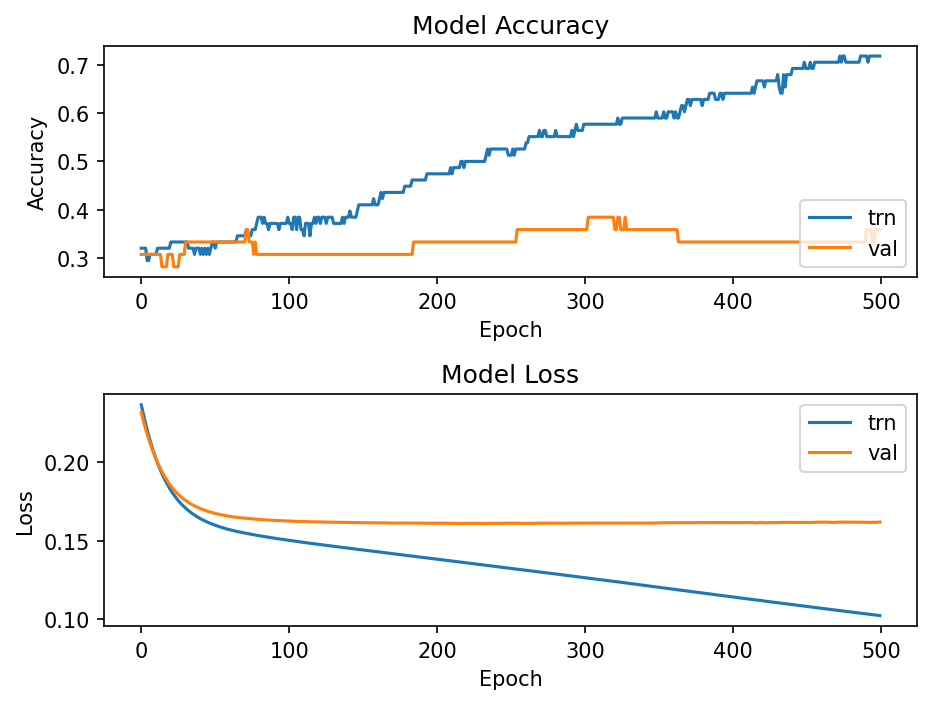

In [ ]:
fig = plt.figure()
plt.subplot(2,1,1)
plt.plot(history.history['accuracy'])
plt.plot(history.history['val_accuracy'])
plt.title('Model Accuracy')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(['trn', 'val'], loc='lower right')

plt.subplot(2,1,2)
plt.plot(history.history['loss'])
plt.plot(history.history['val_loss'])
plt.title('Model Loss')
plt.ylabel('Loss')
plt.xlabel('Epoch')
plt.legend(['trn', 'val'], loc='upper right')

plt.tight_layout()

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from tensorflow import keras

feature_names = train_data.drop(['Type'], axis=1).columns.to_list() 

def permutation_importance(model, X, y, metric, num_iterations=10):

    baseline_score = model.evaluate(X, y, verbose=0)
    baseline_score = baseline_score[model.metrics_names.index(metric_name)]

    feature_importance = np.zeros(X.shape[1])

    for feature in range(X.shape[1]):
        scores = np.zeros(num_iterations)
        for i in range(num_iterations):
            X_permuted = X.copy()
            np.random.shuffle(X_permuted[:, feature])
            scores[i] = model.evaluate(X_permuted, y, verbose=0)
            scores[i] = scores[i][model.metrics_names.index(metric_name)]
        feature_importance[feature] = baseline_score - np.mean(scores)

    return feature_importance

# Assuming you have already trained and compiled your TensorFlow Keras Sequential model
# X_train: Your training feature data
# y_train: Your training target variable
# metric: The evaluation metric you used to train your model (e.g., mean squared error, accuracy)

# Calculate feature importance using permutation importance
importance = permutation_importance(model, X_trn, y_trn, metric_name='binary_accuracy')

# Sort feature importance in descending order
sorted_importance = np.argsort(importance)[::-1]
sorted_names = [feature_names[i] for i in sorted_importance]
sorted_scores = importance[sorted_importance]

# Plot the feature importance
plt.figure(figsize=(10, 6))
plt.bar(range(X_trn.shape[1]), sorted_scores)
plt.xticks(range(X_trn.shape[1]), sorted_names, rotation=90)
plt.xlabel('Features')
plt.ylabel('Importance')
plt.title('Feature Importance')
plt.tight_layout()
plt.show()

In [ ]:
feature_names = train_data.drop(['Type'], axis=1).columns.to_list() 
print(feature_names)
print(len(feature_names))

['original_shape_LeastAxisLength', 'original_shape_MajorAxisLength', 'original_shape_Maximum2DDiameterRow', 'original_shape_Maximum2DDiameterSlice', 'original_shape_Maximum3DDiameter', 'original_shape_MeshVolume', 'original_shape_SurfaceArea', 'original_shape_VoxelVolume', 'original_firstorder_Energy', 'original_firstorder_Kurtosis', 'original_firstorder_TotalEnergy', 'original_glrlm_GrayLevelNonUniformity', 'original_glrlm_LongRunEmphasis', 'original_glrlm_LongRunHighGrayLevelEmphasis', 'original_glrlm_LongRunLowGrayLevelEmphasis', 'original_glrlm_RunLengthNonUniformity', 'original_glrlm_RunVariance', 'original_glszm_GrayLevelNonUniformity', 'original_glszm_LargeAreaEmphasis', 'original_glszm_LargeAreaHighGrayLevelEmphasis', 'original_glszm_LargeAreaLowGrayLevelEmphasis', 'original_glszm_SizeZoneNonUniformity', 'original_glszm_ZoneVariance', 'original_gldm_DependenceNonUniformity', 'original_gldm_GrayLevelNonUniformity', 'original_gldm_LargeDependenceEmphasis', 'original_gldm_LargeDep

Training accuracy:  0.4230769230769231
Testing accuracy:  0.23076923076923078

Classification report (Training):
              precision    recall  f1-score   support

           0       0.59      0.42      0.49        24
           1       0.27      0.29      0.28        14
           2       0.45      0.31      0.37        16
           3       0.35      0.50      0.41        16
           4       0.50      0.75      0.60         8

    accuracy                           0.42        78
   macro avg       0.43      0.45      0.43        78
weighted avg       0.44      0.42      0.42        78


Classification report (Testing):
              precision    recall  f1-score   support

           0       0.40      0.17      0.24        12
           1       0.11      0.25      0.15         4
           2       0.33      0.22      0.27         9
           3       0.25      0.22      0.24         9
           4       0.18      0.40      0.25         5

    accuracy                          

Text(0.5, 36.07499999999998, 'Predicted label')

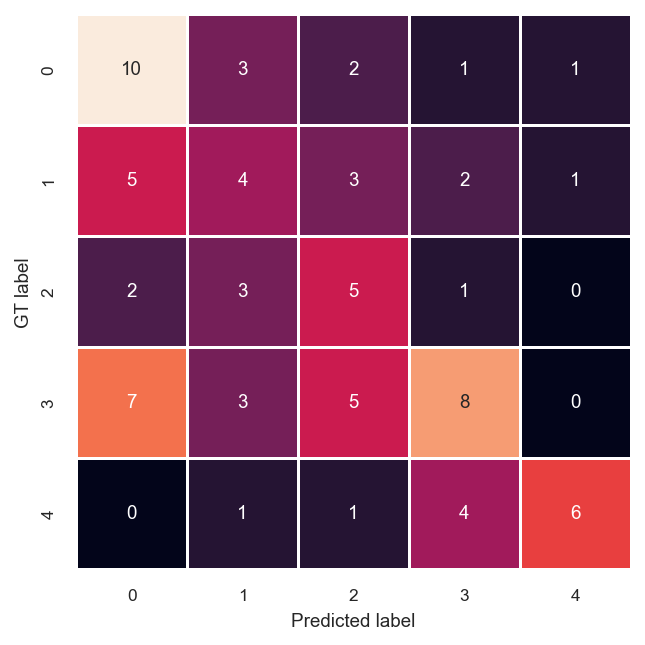

In [ ]:
# SVM
model = GaussianNB()
model.fit(X_trn, y_trn)

y_trn_prd = model.predict(X_trn)
print('Training accuracy: ',
  accuracy_score(y_true=y_trn, y_pred=y_trn_prd))

y_tst_prd = model.predict(X_tst)
print('Testing accuracy: ',
  accuracy_score(y_true=y_tst, y_pred=y_tst_prd))

# Classification summary table
print("\nClassification report (Training):")
print(classification_report(y_trn, y_trn_prd, zero_division=1))

print("\nClassification report (Testing):")
print(classification_report(y_tst, y_tst_prd, zero_division=1))

# Confusion matrix

print("\nConfusion matrix (Training):")
cm_trn = confusion_matrix(y_trn, y_trn_prd)
sns.set(font_scale=0.75)
sns.heatmap(cm_trn.T, square=True, annot=True, fmt='d',
  cbar=False, linewidths=0.5)
plt.ylabel('GT label')
plt.xlabel('Predicted label')







In [ ]:
pbar = tqdm(total=model.n_estimators, desc='Training Progress')

for i in range(model.n_estimators):
    model.set_params(warm_start=True, n_estimators=i+201)
    model.fit(X_train, y_train)
    y_pred = model.predict(X_test)
    accuracy = accuracy_score(y_test, y_pred)
    pbar.set_postfix({'Accuracy': accuracy})
    pbar.update(1)

pbar.close()


Confusion matrix (Testing):


Text(0.5, 36.07499999999998, 'Predicted label')

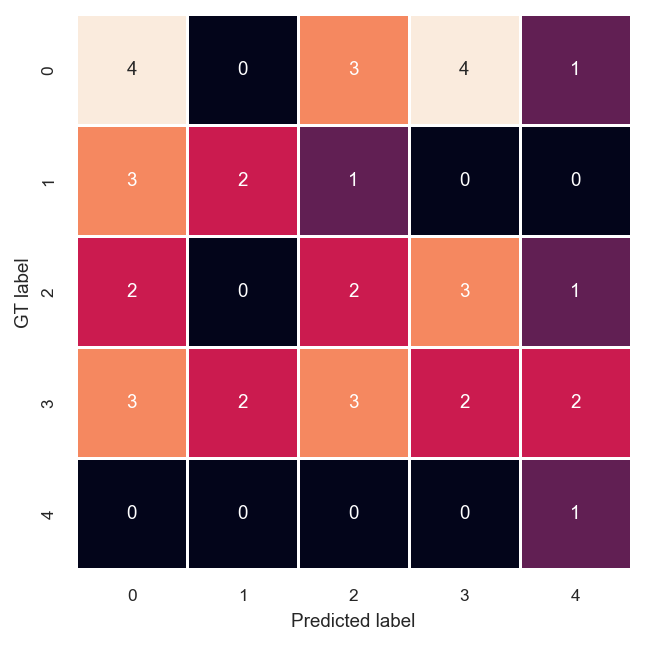

In [ ]:
print("\nConfusion matrix (Testing):")
cm_tst = confusion_matrix(y_tst, y_tst_prd)
sns.set(font_scale=0.75)
sns.heatmap(cm_tst.T, square=True, annot=True, fmt='d',
  cbar=False, linewidths=0.5)
plt.ylabel('GT label')
plt.xlabel('Predicted label')